In [1]:
import glob, os
import matplotlib.pyplot as plt
from nilearn.image import mean_img, load_img
from nilearn.plotting import plot_stat_map, plot_anat, plot_img
from nilearn.glm import threshold_stats_img
plt.ion()

In [2]:
file_dir = ('/lab_data/coaxlab/Projects/loki_1/stat_maps/derivatives/trialwise_response/sub-{}/ses-{}/func/')
file_pattern = ('*sub-{}*ses-{}*run-{}*.nii.gz')

# Show an axial view of the statistical maps 

In [3]:
sessions = range(2,11); runs = range(0,5); n_trials_per_run = 60

In [4]:
stat_type = 'z_maps'

stat_path = os.path.join(file_dir, stat_type, file_pattern)
print(stat_path)

sub = 813
alpha = 0.05
cluster_threshold = 30
cut_coords = (18,34)

/lab_data/coaxlab/Projects/loki_1/stat_maps/derivatives/trialwise_response/sub-{}/ses-{}/func/z_maps/*sub-{}*ses-{}*run-{}*.nii.gz


/home/kbond/.local/lib/python3.7/site-packages/nilearn/plotting/displays.py:786: UserWarning: empty mask
  get_mask_bounds(new_img_like(img, not_mask, affine))
/opt/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/home/kbond/.local/lib/python3.7/site-packages/nilearn/plotting/displays.py:786: UserWarning

KeyboardInterrupt: 

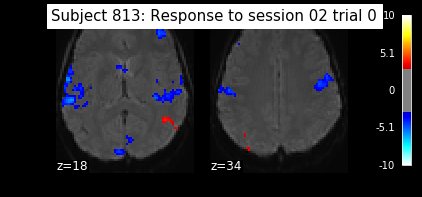

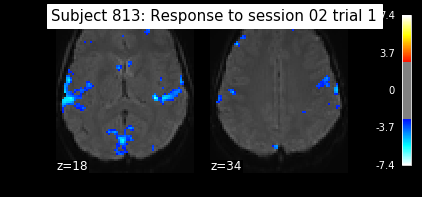

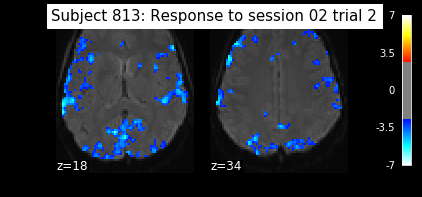

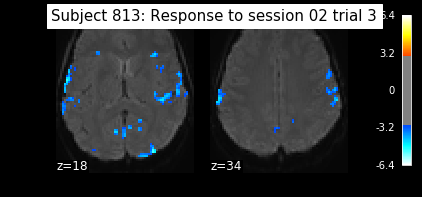

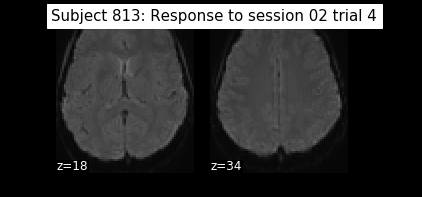

...

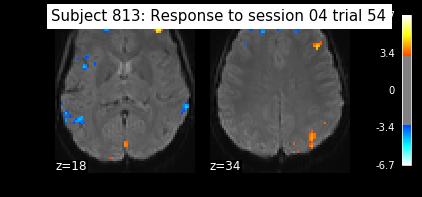

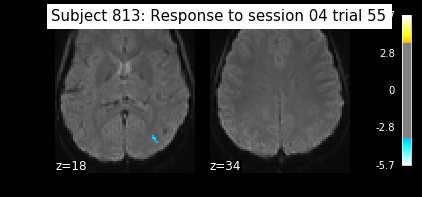

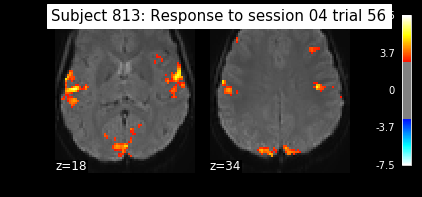

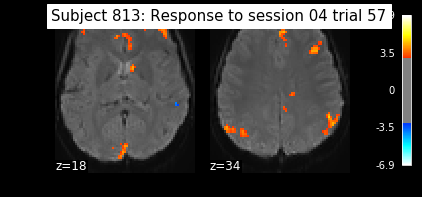

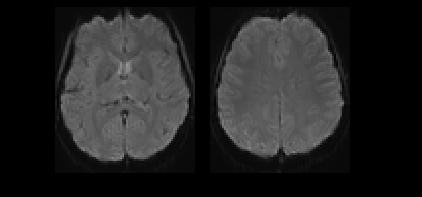

In [5]:
for sess in sessions:
    for run in runs:

        sess = str(sess)
        run = str(run).zfill(2)

        if len(sess) == 1:
            sess = str(sess).zfill(2)

        data_pattern = stat_path.format(sub, sess, sub, sess, run)
        data_files = glob.glob(data_pattern)

        sorted_stat_files = sorted(data_files, key=lambda x:int(x.split('trial-')[1].split('.nii.gz')[0]))
        epi_file = glob.glob('/lab_data/coaxlab/Projects/loki_1/fmriprep_BOLD_data/sub-{}/ses-{}/func/*run-0{}*space-T1w_desc-preproc_bold.nii.gz'.format(sub, sess, int(run)+1))
    
    
        stat_imgs = [load_img(f) for f in sorted_stat_files]
        epi_img = load_img(epi_file)
        
        mean_epi_img = mean_img(epi_img)


        for t in range(n_trials_per_run):

            title = 'Subject {}: Response to session {} trial {}'.format(sub, sess, t)

            clean_map, threshold = threshold_stats_img(
            stat_imgs[t], alpha=alpha, height_control='fdr', cluster_threshold=cluster_threshold)

            plot_stat_map(clean_map, bg_img=mean_epi_img, threshold=threshold,
                      display_mode='z', cut_coords=cut_coords, black_bg=True,
                      title=title)